In [1]:
import os
import zarr
import random
import json
import warnings
import numpy as np
import pandas as pd
import torch.nn as nn
from pathlib import Path
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Dataset
from collections import defaultdict
import sys
import torch
import torchvision.transforms.functional as F
import random

warnings.filterwarnings("ignore")
sys.path.append("./src/")

from src.config import CFG
from src.dataloader import (
    read_zarr,
    read_info_json,
    scale_coordinates,
    create_dataset,
    create_segmentation_map,
    EziiDataset,
    drop_padding,
)
from src.network import UNet_2D, aug
from src.utils import save_images
from src.metric import score, create_cls_pos, create_cls_pos_sikii, create_df
from metric import visualize_epoch_results

In [2]:
train_dataset = EziiDataset(
    exp_names=CFG.train_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.train_zarr_types,
    train=True,
    random=True,
)

train_shuffle_dataset = EziiDataset(
    exp_names=CFG.train_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.train_zarr_types,
    train=True,
)

valid_dataset = EziiDataset(
    exp_names=CFG.valid_exp_names,
    base_dir="../../inputs/train/",
    particles_name=CFG.particles_name,
    resolution=CFG.resolution,
    zarr_type=CFG.valid_zarr_types,
    train=True,
)

from tqdm import tqdm

train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True, drop_last=True)
train_nshuffle_loader = DataLoader(train_shuffle_dataset, batch_size=1, shuffle=False)
valid_loader = DataLoader(valid_dataset, batch_size=1, shuffle=False)

for data in tqdm(train_dataset):
    normalized_tomogram = data["normalized_tomogram"]
    segmentation_map = data["segmentation_map"]
    break

# normalized_tomogram =
normalized_tomogram.shape[0]

[('TS_5_4', 'denoised')]
[('TS_5_4', 'denoised')]
[('TS_86_3', 'denoised'), ('TS_6_6', 'denoised')]


  0%|          | 0/1 [00:00<?, ?it/s]


46

In [3]:
# torchのpadding用の関数
# torch.Size([4, 1, 158, 158]) -> torch.Size([4, 1, 160, 160])


class PadToSize(nn.Module):
    def __init__(self, resolution):
        super().__init__()
        if resolution == "0":
            self.size = 640
        elif resolution == "1":
            self.size = 320
        elif resolution == "2":
            self.size = 160

    def forward(self, x):
        return F.pad(x, (0, 0, self.size - x.shape[-1], self.size - x.shape[-2]))


# test
pad = PadToSize(CFG.resolution)
test_input = torch.randn((4, 1, 158, 158))
print(test_input.shape)
print(pad(test_input).shape)

torch.Size([4, 1, 158, 158])
torch.Size([4, 1, 160, 160])


In [4]:
model = UNet_2D().to("cuda")
# model.load_state_dict(torch.load("./pretrained_model.pth"))
# model.eval()

In [5]:
import matplotlib.pyplot as plt
import numpy as np
from matplotlib.colors import ListedColormap
from matplotlib.patches import Patch

# サンプルデータ
num_classes = len(CFG.particles_name)  # クラス数
colors = plt.cm.tab10(
    np.arange(len(CFG.particles_name))
)  # "tab10" カラーマップから色を取得

# ListedColormap を作成
class_colormap = ListedColormap(colors)


# カラーバー付きプロット
def plot_with_colormap(data, title, original_tomogram):
    masked_data = np.ma.masked_where(data <= 0, data)  # クラス0をマスク
    plt.imshow(original_tomogram, cmap="gray")
    im = plt.imshow(masked_data, cmap=class_colormap)
    plt.title(title)
    plt.axis("off")
    return im

In [6]:
class SegmentationLoss(nn.Module):
    def __init__(self, criterion):
        super().__init__()
        self.softmax = nn.Softmax(dim=1)
        self.criterion = criterion

    def forward(self, output, target):
        # output: (batch, cls, 160, 160)
        # target: (batch, 160, 160)

        # output, (batch, 160, 160, cls) -> (batch, 160, 160, cls)
        # output = output.permute(0, 2, 3, 1)
        # output = output.reshape(-1, output.shape[-1])  # (batch*160*160, cls)

        # target, (batch, 160, 160) -> (batch*160*160)
        # target = target.reshape(-1)

        loss = self.criterion(output, target)
        return loss


class DiceLoss(nn.Module):
    def __init__(self, smooth=1e-6):
        super().__init__()
        self.smooth = smooth

    def forward(self, output, target):
        """
        output: (batch, cls, height, width)
        target: (batch, height, width)
        """
        # Apply softmax to get probabilities
        output = nn.functional.softmax(output, dim=1)

        # One-hot encode the target to match the number of classes in output
        num_classes = output.shape[1]
        target_one_hot = (
            # F.one_hot(target, num_classes=num_classes).permute(0, 3, 1, 2).float()
            nn.functional.one_hot(target, num_classes=num_classes)
            .permute(0, 3, 1, 2)
            .float()
        )

        # Flatten for Dice calculation
        output_flat = output.reshape(output.shape[0], output.shape[1], -1)
        target_flat = target_one_hot.reshape(
            target_one_hot.shape[0], target_one_hot.shape[1], -1
        )

        # Compute intersection and union
        intersection = (output_flat * target_flat).sum(dim=2)
        union = output_flat.sum(dim=2) + target_flat.sum(dim=2)

        # Compute Dice score
        dice_score = (2.0 * intersection + self.smooth) / (union + self.smooth)

        # Average over classes and batch
        dice_loss = 1.0 - dice_score.mean()

        return dice_loss


# test
dice_loss = DiceLoss()
output = torch.randn((4, 3, 160, 160))
target = torch.randint(0, 3, (4, 160, 160))
print(dice_loss(output, target))

tensor(0.6668)


In [7]:
from transformers import get_cosine_schedule_with_warmup

batch_size = CFG.batch_size

optimizer = torch.optim.AdamW(model.parameters(), lr=CFG.lr)
# criterion = nn.CrossEntropyLoss(
#     #  weight=torch.tensor([2.0, 32, 32, 32, 32, 32, 32]).to("cuda")
# )
criterion = DiceLoss()
scheduler = get_cosine_schedule_with_warmup(
    optimizer,
    num_warmup_steps=CFG.epochs // 10,
    num_training_steps=CFG.epochs
    * len(train_loader)
    * (normalized_tomogram.shape[0] // batch_size),
    # * batch_size,
)
seg_loss = SegmentationLoss(criterion)
padf = PadToSize(CFG.resolution)

Train-Epoch: 0, Loss: 0.9520002206166586: : 6it [00:01,  5.09it/s]                     
Train-nshuffle-Epoch: 0, Loss: 0.9724340594333151: 100%|██████████| 46/46 [00:00<00:00, 133.42it/s]


EPOCH: 0, TRAIN_SCORE: 0.0011341852236287973, TRAIN_SCORE_LIST: [0.0011341852236287973]
EPOCH: 0, TRAIN_EASY_SCORE: 0.06437498126183043, TRAIN_EASY_SCORE_LIST: [0.06437498126183043]


Valid-Epoch: 0, Loss: 0.9747013002634048: 100%|██████████| 92/92 [00:00<00:00, 138.97it/s]


EPOCH: 0, VALID_SCORE: 0.004311982214478382, VALID_SCORE_LIST: [0.004229880273183918, 0.0043940841557728455]
EPOCH: 0, VALID_EASY_SCORE: 0.041235524223389025, VALID_EASY_SCORE_LIST: [0.05430863287738564, 0.02816241556939242]


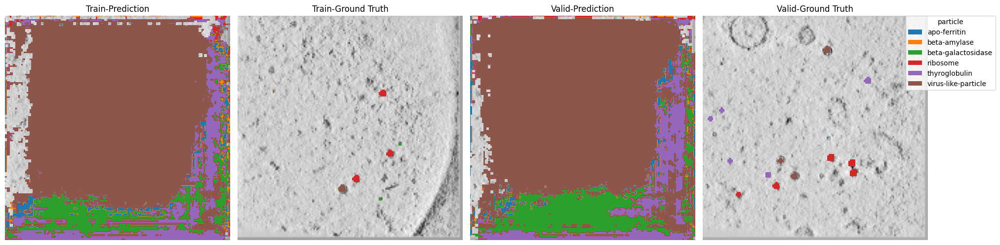

Train-Epoch: 1, Loss: 0.9217532277107239: : 6it [00:00, 11.89it/s]                     
Train-nshuffle-Epoch: 1, Loss: 0.9084988262342371: 100%|██████████| 46/46 [00:00<00:00, 144.16it/s]


EPOCH: 1, TRAIN_SCORE: 0.0013325121834558203, TRAIN_SCORE_LIST: [0.0013325121834558203]
EPOCH: 1, TRAIN_EASY_SCORE: 0.050232510936509385, TRAIN_EASY_SCORE_LIST: [0.050232510936509385]


Valid-Epoch: 1, Loss: 0.9105953755586044: 100%|██████████| 92/92 [00:00<00:00, 128.85it/s]


EPOCH: 1, VALID_SCORE: 0.00035008204392182536, VALID_SCORE_LIST: [0.00027210884353741496, 0.00042805524430623577]
EPOCH: 1, VALID_EASY_SCORE: 0.04040287407042898, VALID_EASY_SCORE_LIST: [0.03133377156323664, 0.04947197657762132]


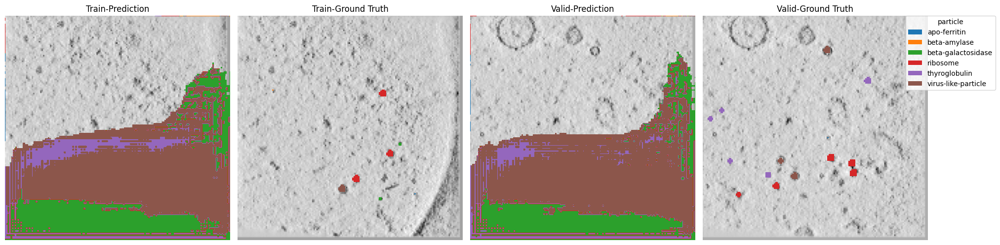

Train-Epoch: 2, Loss: 0.9009227852026621: : 6it [00:00, 13.88it/s]                     
Train-nshuffle-Epoch: 2, Loss: 0.9087307686391084: 100%|██████████| 46/46 [00:00<00:00, 133.38it/s]


EPOCH: 2, TRAIN_SCORE: 0.002950876583926402, TRAIN_SCORE_LIST: [0.002950876583926402]
EPOCH: 2, TRAIN_EASY_SCORE: 0.13154464477926006, TRAIN_EASY_SCORE_LIST: [0.13154464477926006]


Valid-Epoch: 2, Loss: 0.9097856859798017: 100%|██████████| 92/92 [00:00<00:00, 130.03it/s]


EPOCH: 2, VALID_SCORE: 0.0, VALID_SCORE_LIST: [0.0, 0.0]
EPOCH: 2, VALID_EASY_SCORE: 0.10694795479585639, VALID_EASY_SCORE_LIST: [0.0973559750954238, 0.11653993449628897]


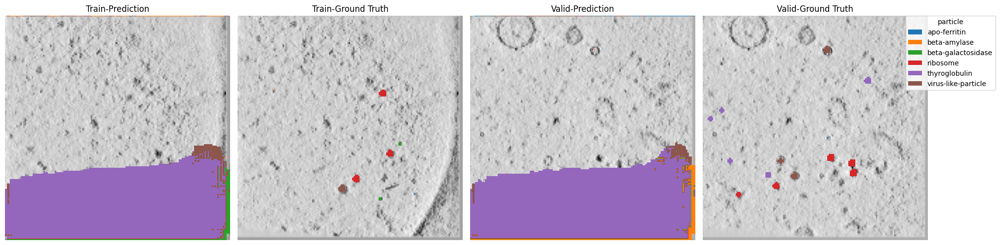

Train-Epoch: 3, Loss: 0.885260283946991: : 6it [00:00, 11.72it/s]                      
Train-nshuffle-Epoch: 3, Loss: 0.8865290621052617: 100%|██████████| 46/46 [00:00<00:00, 132.41it/s]


EPOCH: 3, TRAIN_SCORE: 0.019122609673790775, TRAIN_SCORE_LIST: [0.019122609673790775]
EPOCH: 3, TRAIN_EASY_SCORE: 0.06897959183673469, TRAIN_EASY_SCORE_LIST: [0.06897959183673469]


Valid-Epoch: 3, Loss: 0.890024382783019: 100%|██████████| 92/92 [00:00<00:00, 129.14it/s] 


EPOCH: 3, VALID_SCORE: 0.02865925497504445, VALID_SCORE_LIST: [0.017989417989417993, 0.03932909196067091]
EPOCH: 3, VALID_EASY_SCORE: 0.05595754445812341, VALID_EASY_SCORE_LIST: [0.05588890485771774, 0.056026184058529084]


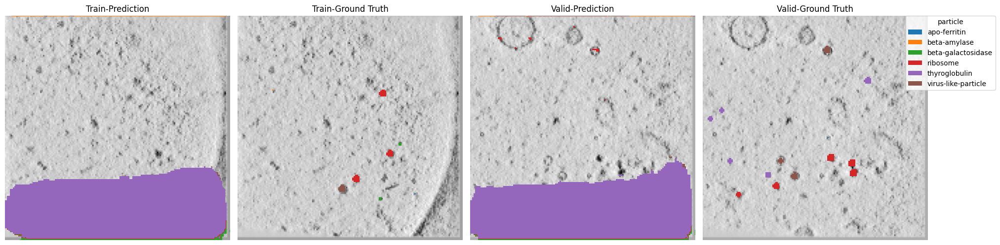

Train-Epoch: 4, Loss: 0.8728563586870829: : 6it [00:00, 11.20it/s]                     
Train-nshuffle-Epoch: 4, Loss: 0.8625583661639172: 100%|██████████| 46/46 [00:00<00:00, 138.77it/s]


EPOCH: 4, TRAIN_SCORE: 0.062182483235114806, TRAIN_SCORE_LIST: [0.062182483235114806]
EPOCH: 4, TRAIN_EASY_SCORE: 0.05839842635111504, TRAIN_EASY_SCORE_LIST: [0.05839842635111504]


Valid-Epoch: 4, Loss: 0.8672403505314952: 100%|██████████| 92/92 [00:00<00:00, 121.01it/s]


EPOCH: 4, VALID_SCORE: 0.01919672568192749, VALID_SCORE_LIST: [0.02068819186029657, 0.017705259503558408]
EPOCH: 4, VALID_EASY_SCORE: 0.04895683610667233, VALID_EASY_SCORE_LIST: [0.04294417992941889, 0.054969492283925774]


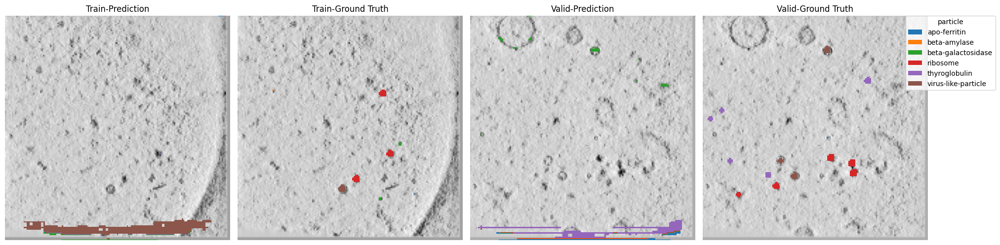

Train-Epoch: 5, Loss: 0.8587455749511719: : 6it [00:00, 11.62it/s]                     
Train-nshuffle-Epoch: 5, Loss: 0.8509911622690118: 100%|██████████| 46/46 [00:00<00:00, 139.17it/s]


EPOCH: 5, TRAIN_SCORE: 0.053208137715179966, TRAIN_SCORE_LIST: [0.053208137715179966]
EPOCH: 5, TRAIN_EASY_SCORE: 0.12951770037122085, TRAIN_EASY_SCORE_LIST: [0.12951770037122085]


Valid-Epoch: 5, Loss: 0.8576530891916027: 100%|██████████| 92/92 [00:00<00:00, 130.76it/s]


EPOCH: 5, VALID_SCORE: 0.020913860500247183, VALID_SCORE_LIST: [0.01884439517805182, 0.022983325822442547]
EPOCH: 5, VALID_EASY_SCORE: 0.0647878379070443, VALID_EASY_SCORE_LIST: [0.08117547208399663, 0.04840020373009197]


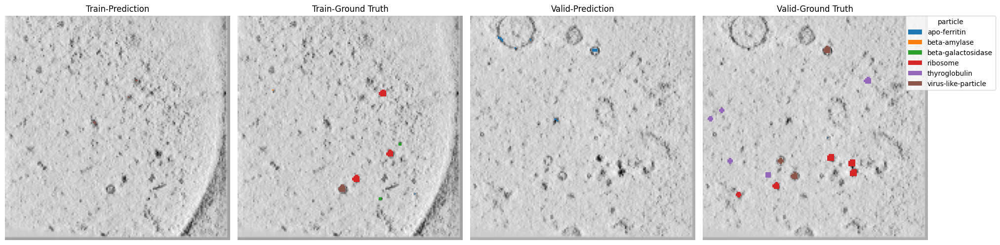

Train-Epoch: 6, Loss: 0.8430599967638651: : 6it [00:00, 10.85it/s]                     
Train-nshuffle-Epoch: 6, Loss: 0.8455986160299053: 100%|██████████| 46/46 [00:00<00:00, 136.82it/s]


EPOCH: 6, TRAIN_SCORE: 0.0407023144453312, TRAIN_SCORE_LIST: [0.0407023144453312]
EPOCH: 6, TRAIN_EASY_SCORE: 0.11553017159655951, TRAIN_EASY_SCORE_LIST: [0.11553017159655951]


Valid-Epoch: 6, Loss: 0.8559222234332043: 100%|██████████| 92/92 [00:00<00:00, 124.72it/s]


EPOCH: 6, VALID_SCORE: 0.021962908035242885, VALID_SCORE_LIST: [0.030217981102067547, 0.013707834968418224]
EPOCH: 6, VALID_EASY_SCORE: 0.06140168288906202, VALID_EASY_SCORE_LIST: [0.07467711588681022, 0.0481262498913138]


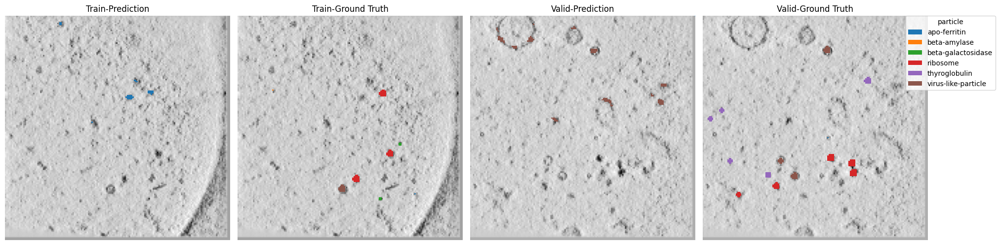

Train-Epoch: 7, Loss: 0.8395894169807434: : 6it [00:00, 12.52it/s]                     
Train-nshuffle-Epoch: 7, Loss: 0.8201423339221788: 100%|██████████| 46/46 [00:00<00:00, 141.81it/s]


EPOCH: 7, TRAIN_SCORE: 0.02913453299057412, TRAIN_SCORE_LIST: [0.02913453299057412]
EPOCH: 7, TRAIN_EASY_SCORE: 0.05066683101195612, TRAIN_EASY_SCORE_LIST: [0.05066683101195612]


Valid-Epoch: 7, Loss: 0.8431782871484756: 100%|██████████| 92/92 [00:00<00:00, 130.38it/s]


EPOCH: 7, VALID_SCORE: 0.023136485191627306, VALID_SCORE_LIST: [0.03454074125972114, 0.011732229123533474]
EPOCH: 7, VALID_EASY_SCORE: 0.07522013144349125, VALID_EASY_SCORE_LIST: [0.10330825138420711, 0.047132011502775385]


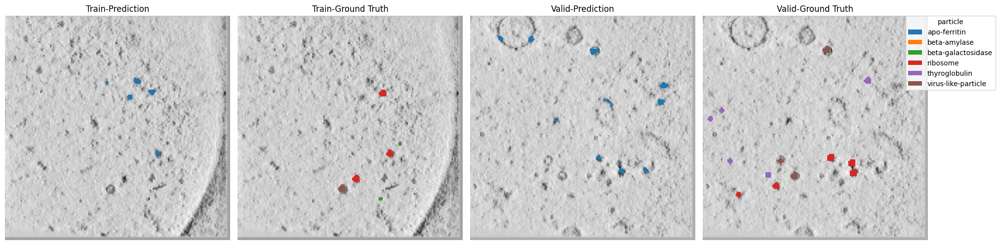

Train-Epoch: 8, Loss: 0.8321415285269419: : 6it [00:00, 11.76it/s]                     
Train-nshuffle-Epoch: 8, Loss: 0.8116189850413281: 100%|██████████| 46/46 [00:00<00:00, 136.31it/s]


EPOCH: 8, TRAIN_SCORE: 0.020628792057363485, TRAIN_SCORE_LIST: [0.020628792057363485]
EPOCH: 8, TRAIN_EASY_SCORE: 0.05045843045843045, TRAIN_EASY_SCORE_LIST: [0.05045843045843045]


Valid-Epoch: 8, Loss: 0.8306429962749067: 100%|██████████| 92/92 [00:00<00:00, 132.21it/s]


EPOCH: 8, VALID_SCORE: 0.014028118617343464, VALID_SCORE_LIST: [0.012369633761823913, 0.015686603472863016]
EPOCH: 8, VALID_EASY_SCORE: 0.04212301204784335, VALID_EASY_SCORE_LIST: [0.036990290366049505, 0.04725573372963719]


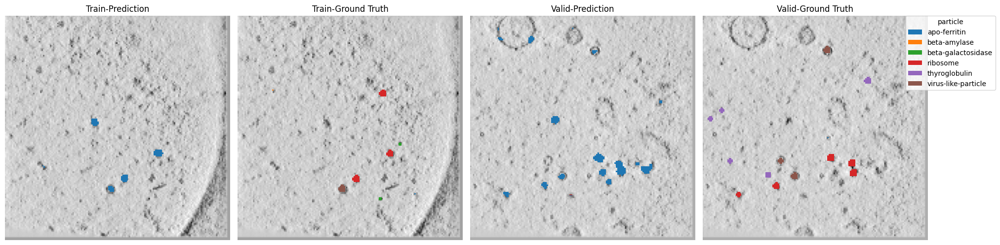

Train-Epoch: 9, Loss: 0.8261585732301077: : 6it [00:00, 10.75it/s]                     
Train-nshuffle-Epoch: 9, Loss: 0.8031348586082458: 100%|██████████| 46/46 [00:00<00:00, 144.90it/s]


EPOCH: 9, TRAIN_SCORE: 0.043008939112835216, TRAIN_SCORE_LIST: [0.043008939112835216]
EPOCH: 9, TRAIN_EASY_SCORE: 0.08971125033685448, TRAIN_EASY_SCORE_LIST: [0.08971125033685448]


Valid-Epoch: 9, Loss: 0.8264059314261312: 100%|██████████| 92/92 [00:00<00:00, 124.22it/s]


EPOCH: 9, VALID_SCORE: 0.018184218312391434, VALID_SCORE_LIST: [0.022235140241244004, 0.014133296383538867]
EPOCH: 9, VALID_EASY_SCORE: 0.08794600601782053, VALID_EASY_SCORE_LIST: [0.06987048737511777, 0.1060215246605233]


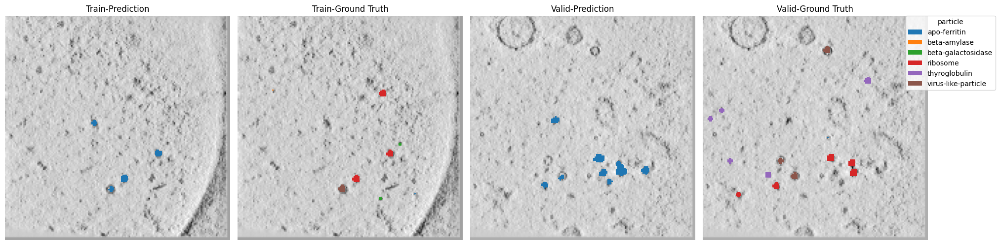

Train-Epoch: 10, Loss: 0.8161322474479675: : 6it [00:00, 15.14it/s]                     
Train-nshuffle-Epoch: 10, Loss: 0.8384615338366964: 100%|██████████| 46/46 [00:00<00:00, 145.19it/s]


EPOCH: 10, TRAIN_SCORE: 0.15967630253344536, TRAIN_SCORE_LIST: [0.15967630253344536]
EPOCH: 10, TRAIN_EASY_SCORE: 0.06614240106938883, TRAIN_EASY_SCORE_LIST: [0.06614240106938883]


Valid-Epoch: 10, Loss: 0.8550775213086087: 100%|██████████| 92/92 [00:00<00:00, 125.44it/s]


EPOCH: 10, VALID_SCORE: 0.04624939442618729, VALID_SCORE_LIST: [0.04887799244227865, 0.04362079641009594]
EPOCH: 10, VALID_EASY_SCORE: 0.05861681523472019, VALID_EASY_SCORE_LIST: [0.04990806063718434, 0.06732556983225604]


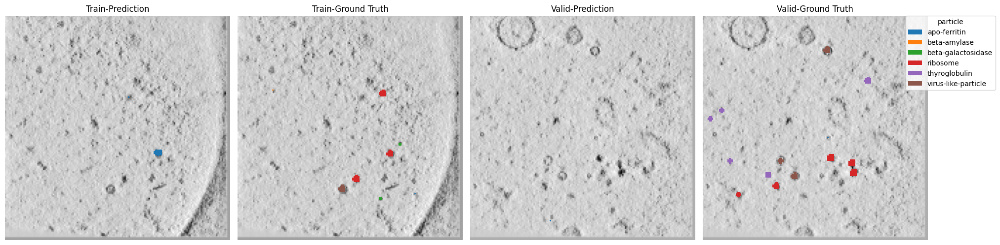

Train-Epoch: 11, Loss: 0.8132500648498535: : 6it [00:00, 15.05it/s]                     
Train-nshuffle-Epoch: 11, Loss: 0.8137002613233484: 100%|██████████| 46/46 [00:00<00:00, 139.05it/s]


EPOCH: 11, TRAIN_SCORE: 0.03704467285167652, TRAIN_SCORE_LIST: [0.03704467285167652]
EPOCH: 11, TRAIN_EASY_SCORE: 0.05287580723543756, TRAIN_EASY_SCORE_LIST: [0.05287580723543756]


Valid-Epoch: 11, Loss: 0.8380658302618109: 100%|██████████| 92/92 [00:00<00:00, 126.52it/s]


EPOCH: 11, VALID_SCORE: 0.03317226778062317, VALID_SCORE_LIST: [0.033676476236973764, 0.03266805932427257]
EPOCH: 11, VALID_EASY_SCORE: 0.04668949682525329, VALID_EASY_SCORE_LIST: [0.04180646746493361, 0.05157252618557297]


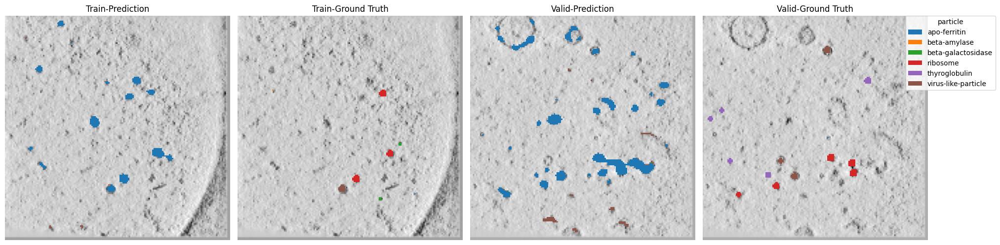

Train-Epoch: 12, Loss: 0.8201420903205872: : 6it [00:00, 10.49it/s]                     
Train-nshuffle-Epoch: 12, Loss: 0.7842571139335632: 100%|██████████| 46/46 [00:00<00:00, 139.11it/s]


EPOCH: 12, TRAIN_SCORE: 0.11464441590508814, TRAIN_SCORE_LIST: [0.11464441590508814]
EPOCH: 12, TRAIN_EASY_SCORE: 0.0578507763519184, TRAIN_EASY_SCORE_LIST: [0.0578507763519184]


Valid-Epoch: 12, Loss: 0.8396119423534559: 100%|██████████| 92/92 [00:00<00:00, 130.41it/s]


EPOCH: 12, VALID_SCORE: 0.0450885389458148, VALID_SCORE_LIST: [0.04297861551084111, 0.04719846238078849]
EPOCH: 12, VALID_EASY_SCORE: 0.04801793341638026, VALID_EASY_SCORE_LIST: [0.04107629716145027, 0.054959569671310264]


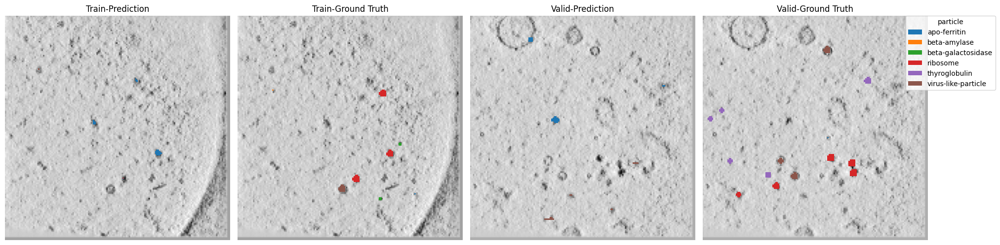

Train-Epoch: 13, Loss: 0.8186882932980856: : 6it [00:00, 11.79it/s]                     
Train-nshuffle-Epoch: 13, Loss: 0.7820395425609921: 100%|██████████| 46/46 [00:00<00:00, 139.21it/s]


EPOCH: 13, TRAIN_SCORE: 0.10349953455188708, TRAIN_SCORE_LIST: [0.10349953455188708]
EPOCH: 13, TRAIN_EASY_SCORE: 0.0592605155420736, TRAIN_EASY_SCORE_LIST: [0.0592605155420736]


Valid-Epoch: 13, Loss: 0.817731639613276: 100%|██████████| 92/92 [00:00<00:00, 136.97it/s] 


EPOCH: 13, VALID_SCORE: 0.050282897814430204, VALID_SCORE_LIST: [0.054423711469819044, 0.04614208415904136]
EPOCH: 13, VALID_EASY_SCORE: 0.05463348382713689, VALID_EASY_SCORE_LIST: [0.052439868474356874, 0.05682709917991691]


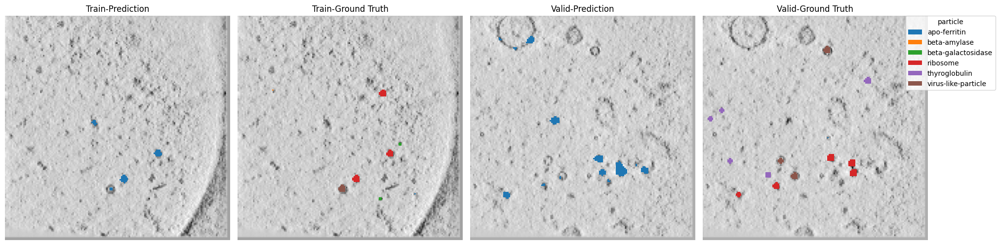

Train-Epoch: 14, Loss: 0.8061612049738566: : 6it [00:00, 11.01it/s]                     
Train-nshuffle-Epoch: 14, Loss: 0.7801610024079032: 100%|██████████| 46/46 [00:00<00:00, 133.17it/s]


EPOCH: 14, TRAIN_SCORE: 0.2142125833368819, TRAIN_SCORE_LIST: [0.2142125833368819]
EPOCH: 14, TRAIN_EASY_SCORE: 0.07425795064595922, TRAIN_EASY_SCORE_LIST: [0.07425795064595922]


Valid-Epoch: 14, Loss: 0.826074917031371: 100%|██████████| 92/92 [00:00<00:00, 123.87it/s] 


EPOCH: 14, VALID_SCORE: 0.09624226779108982, VALID_SCORE_LIST: [0.119751774270929, 0.07273276131125063]
EPOCH: 14, VALID_EASY_SCORE: 0.07032099850001902, VALID_EASY_SCORE_LIST: [0.06950909281729463, 0.07113290418274343]


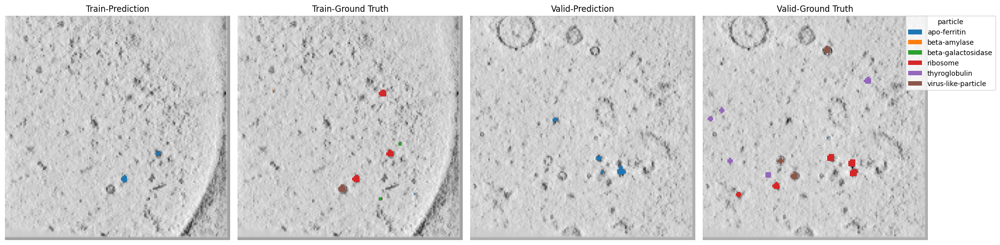

Train-Epoch: 15, Loss: 0.8094491958618164: : 6it [00:00, 13.51it/s]                     
Train-nshuffle-Epoch: 15, Loss: 0.7600775257400845: 100%|██████████| 46/46 [00:00<00:00, 145.01it/s]


EPOCH: 15, TRAIN_SCORE: 0.10400195073874016, TRAIN_SCORE_LIST: [0.10400195073874016]
EPOCH: 15, TRAIN_EASY_SCORE: 0.05733511391361977, TRAIN_EASY_SCORE_LIST: [0.05733511391361977]


Valid-Epoch: 15, Loss: 0.8227896508963212: 100%|██████████| 92/92 [00:00<00:00, 132.38it/s]


EPOCH: 15, VALID_SCORE: 0.06909976397989441, VALID_SCORE_LIST: [0.08525977873621694, 0.05293974922357187]
EPOCH: 15, VALID_EASY_SCORE: 0.05251301303826811, VALID_EASY_SCORE_LIST: [0.04618247377140456, 0.058843552305131656]


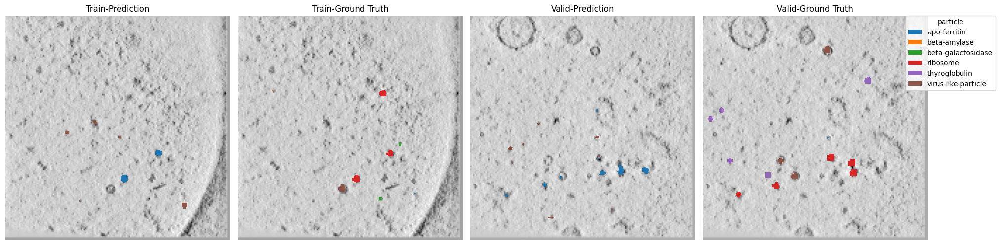

Train-Epoch: 16, Loss: 0.799349973599116: : 6it [00:00, 12.53it/s]                      
Train-nshuffle-Epoch: 16, Loss: 0.7745913759521816: 100%|██████████| 46/46 [00:00<00:00, 134.61it/s]


EPOCH: 16, TRAIN_SCORE: 0.2101845482262818, TRAIN_SCORE_LIST: [0.2101845482262818]
EPOCH: 16, TRAIN_EASY_SCORE: 0.07439225820829638, TRAIN_EASY_SCORE_LIST: [0.07439225820829638]


Valid-Epoch: 16, Loss: 0.8287265028642572: 100%|██████████| 92/92 [00:00<00:00, 125.23it/s]


EPOCH: 16, VALID_SCORE: 0.09655872199101144, VALID_SCORE_LIST: [0.09868267126768027, 0.09443477271434261]
EPOCH: 16, VALID_EASY_SCORE: 0.07130573063732079, VALID_EASY_SCORE_LIST: [0.07371257687971802, 0.06889888439492355]


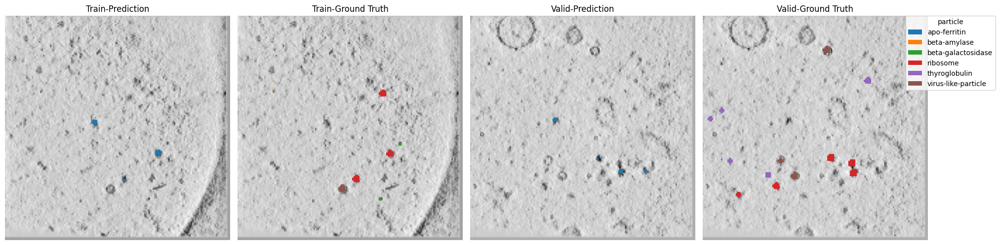

Train-Epoch: 17, Loss: 0.7942662437756857: : 6it [00:00, 11.15it/s]                     
Train-nshuffle-Epoch: 17, Loss: 0.7579735478629237: 100%|██████████| 46/46 [00:00<00:00, 132.45it/s]


EPOCH: 17, TRAIN_SCORE: 0.1097483066155615, TRAIN_SCORE_LIST: [0.1097483066155615]
EPOCH: 17, TRAIN_EASY_SCORE: 0.055170945449336144, TRAIN_EASY_SCORE_LIST: [0.055170945449336144]


Valid-Epoch: 17, Loss: 0.8095201966555222: 100%|██████████| 92/92 [00:00<00:00, 134.51it/s]


EPOCH: 17, VALID_SCORE: 0.069055705951196, VALID_SCORE_LIST: [0.07531416329446539, 0.06279724860792664]
EPOCH: 17, VALID_EASY_SCORE: 0.053375273892913466, VALID_EASY_SCORE_LIST: [0.04535903732726766, 0.06139151045855927]


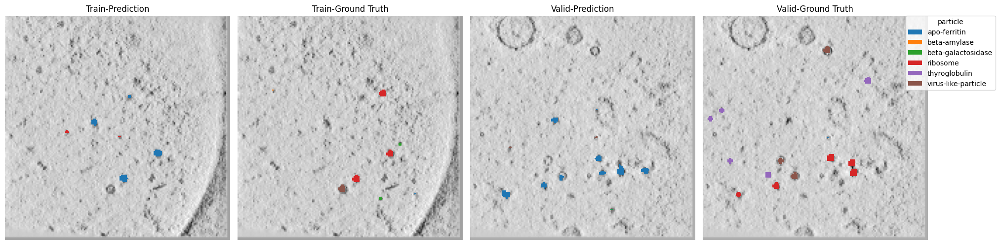

Train-Epoch: 18, Loss: 0.8031104306379954: : 6it [00:00, 11.42it/s]                     
Train-nshuffle-Epoch: 18, Loss: 0.7534354458684507: 100%|██████████| 46/46 [00:00<00:00, 144.33it/s]


EPOCH: 18, TRAIN_SCORE: 0.09929255544231674, TRAIN_SCORE_LIST: [0.09929255544231674]
EPOCH: 18, TRAIN_EASY_SCORE: 0.055682445234446175, TRAIN_EASY_SCORE_LIST: [0.055682445234446175]


Valid-Epoch: 18, Loss: 0.8164924065703931: 100%|██████████| 92/92 [00:00<00:00, 116.45it/s]


EPOCH: 18, VALID_SCORE: 0.0741928620741068, VALID_SCORE_LIST: [0.07524987440420845, 0.07313584974400514]
EPOCH: 18, VALID_EASY_SCORE: 0.07528733365806452, VALID_EASY_SCORE_LIST: [0.04533123432787651, 0.10524343298825253]


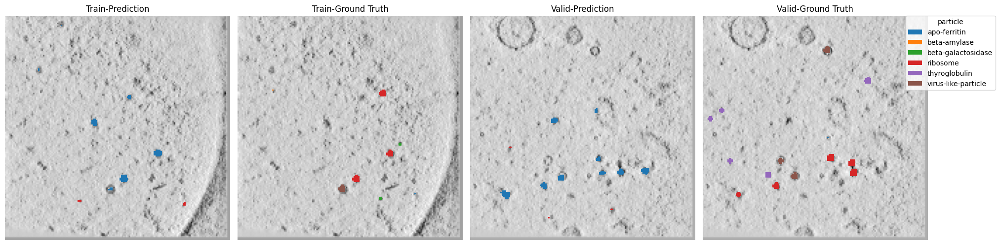

Train-Epoch: 19, Loss: 0.7948333323001862: : 6it [00:00, 17.66it/s]                     
Train-nshuffle-Epoch: 19, Loss: 0.7442815083524456: 100%|██████████| 46/46 [00:00<00:00, 137.12it/s]


EPOCH: 19, TRAIN_SCORE: 0.175674685673848, TRAIN_SCORE_LIST: [0.175674685673848]
EPOCH: 19, TRAIN_EASY_SCORE: 0.09803206713770254, TRAIN_EASY_SCORE_LIST: [0.09803206713770254]


Valid-Epoch: 19, Loss: 0.821672146734984: 100%|██████████| 92/92 [00:00<00:00, 138.10it/s] 


EPOCH: 19, VALID_SCORE: 0.1359857338823699, VALID_SCORE_LIST: [0.15140003079497952, 0.12057143696976029]
EPOCH: 19, VALID_EASY_SCORE: 0.06633239821262396, VALID_EASY_SCORE_LIST: [0.0597904413335422, 0.07287435509170571]


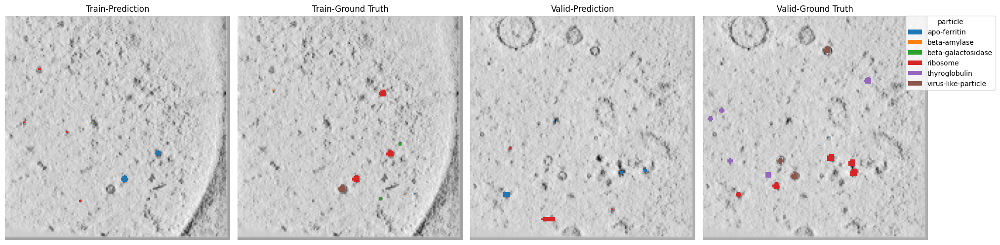

Train-Epoch: 20, Loss: 0.7958019773165385: : 6it [00:00, 13.29it/s]                     
Train-nshuffle-Epoch: 20, Loss: 0.7495763638745183: 100%|██████████| 46/46 [00:00<00:00, 135.79it/s]


EPOCH: 20, TRAIN_SCORE: 0.22760843142109324, TRAIN_SCORE_LIST: [0.22760843142109324]
EPOCH: 20, TRAIN_EASY_SCORE: 0.07770179275489544, TRAIN_EASY_SCORE_LIST: [0.07770179275489544]


Valid-Epoch: 20, Loss: 0.8227280767067618: 100%|██████████| 92/92 [00:00<00:00, 123.84it/s]


EPOCH: 20, VALID_SCORE: 0.14794563657019724, VALID_SCORE_LIST: [0.17138605089324174, 0.12450522224715276]
EPOCH: 20, VALID_EASY_SCORE: 0.06366336100698716, VALID_EASY_SCORE_LIST: [0.06625419193165562, 0.061072530082318714]


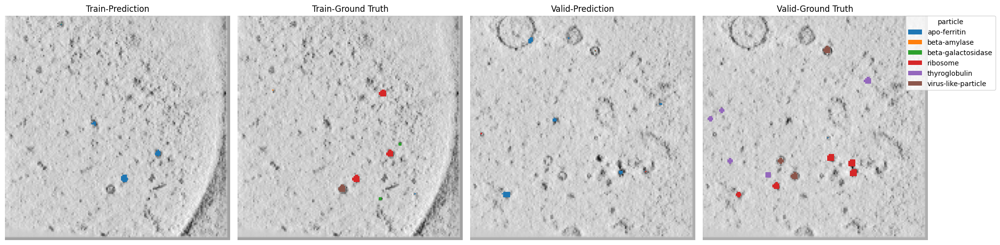

Train-Epoch: 21, Loss: 0.7919677992661794: : 6it [00:00, 12.11it/s]                     
Train-nshuffle-Epoch: 21, Loss: 0.7654580758965533: 100%|██████████| 46/46 [00:00<00:00, 138.34it/s]


EPOCH: 21, TRAIN_SCORE: 0.3413728390117184, TRAIN_SCORE_LIST: [0.3413728390117184]
EPOCH: 21, TRAIN_EASY_SCORE: 0.07677047962715931, TRAIN_EASY_SCORE_LIST: [0.07677047962715931]


Valid-Epoch: 21, Loss: 0.8382761167443317: 100%|██████████| 92/92 [00:00<00:00, 116.53it/s]


EPOCH: 21, VALID_SCORE: 0.15079721966056808, VALID_SCORE_LIST: [0.17112698212842783, 0.1304674571927083]
EPOCH: 21, VALID_EASY_SCORE: 0.08274317137951138, VALID_EASY_SCORE_LIST: [0.08299093626157406, 0.08249540649744871]


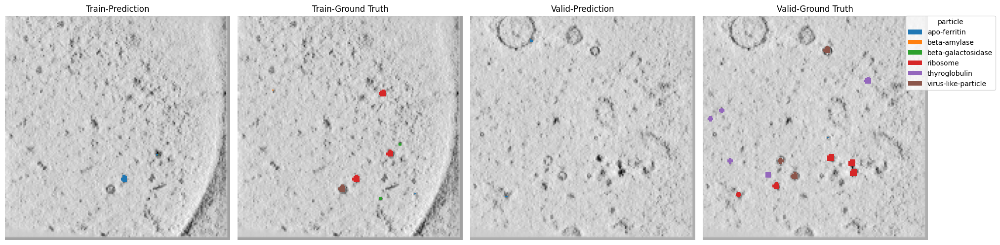

Train-Epoch: 22, Loss: 0.7922022740046183: : 6it [00:00, 13.92it/s]                     
Train-nshuffle-Epoch: 22, Loss: 0.7569966549458711: 100%|██████████| 46/46 [00:00<00:00, 142.14it/s]


EPOCH: 22, TRAIN_SCORE: 0.09755259065950453, TRAIN_SCORE_LIST: [0.09755259065950453]
EPOCH: 22, TRAIN_EASY_SCORE: 0.05555971599416156, TRAIN_EASY_SCORE_LIST: [0.05555971599416156]


Valid-Epoch: 22, Loss: 0.809105031516241: 100%|██████████| 92/92 [00:00<00:00, 118.12it/s] 


EPOCH: 22, VALID_SCORE: 0.07161365736150621, VALID_SCORE_LIST: [0.07943663509561265, 0.06379067962739977]
EPOCH: 22, VALID_EASY_SCORE: 0.053230156339620374, VALID_EASY_SCORE_LIST: [0.04996242163364684, 0.056497891045593905]


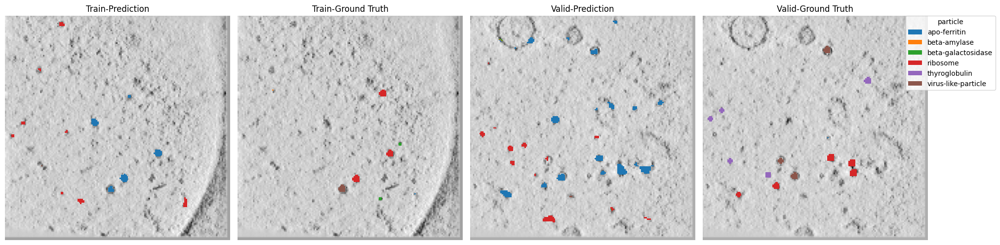

Train-Epoch: 23, Loss: 0.7761846880118052: : 6it [00:00, 14.81it/s]                     
Train-nshuffle-Epoch: 23, Loss: 0.7246201634407043: 100%|██████████| 46/46 [00:00<00:00, 147.28it/s]


EPOCH: 23, TRAIN_SCORE: 0.15773494714035236, TRAIN_SCORE_LIST: [0.15773494714035236]
EPOCH: 23, TRAIN_EASY_SCORE: 0.05993641401437091, TRAIN_EASY_SCORE_LIST: [0.05993641401437091]


Valid-Epoch: 23, Loss: 0.8114908506040988: 100%|██████████| 92/92 [00:00<00:00, 115.53it/s]


EPOCH: 23, VALID_SCORE: 0.08678584184004651, VALID_SCORE_LIST: [0.08776742346157503, 0.08580426021851799]
EPOCH: 23, VALID_EASY_SCORE: 0.059686914645635664, VALID_EASY_SCORE_LIST: [0.057060303075811836, 0.0623135262154595]


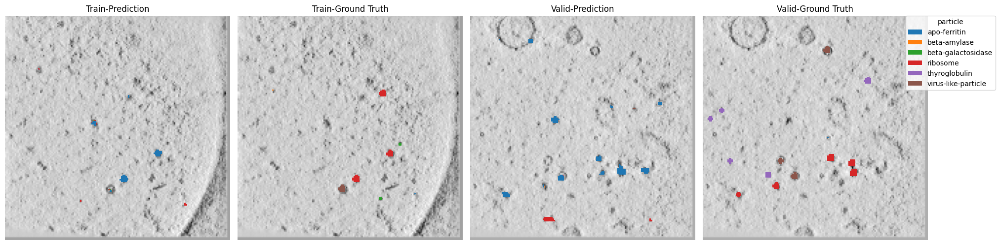

Train-Epoch: 24, Loss: 0.7781764169534048: : 6it [00:00, 11.50it/s]                     
Train-nshuffle-Epoch: 24, Loss: 0.7266578143057616: 100%|██████████| 46/46 [00:00<00:00, 125.19it/s]


EPOCH: 24, TRAIN_SCORE: 0.33887786642923706, TRAIN_SCORE_LIST: [0.33887786642923706]
EPOCH: 24, TRAIN_EASY_SCORE: 0.06866460983363247, TRAIN_EASY_SCORE_LIST: [0.06866460983363247]


Valid-Epoch: 24, Loss: 0.823087075482244: 100%|██████████| 92/92 [00:00<00:00, 117.32it/s] 


EPOCH: 24, VALID_SCORE: 0.12092993439589228, VALID_SCORE_LIST: [0.1252814149525441, 0.11657845383924044]
EPOCH: 24, VALID_EASY_SCORE: 0.08792353219588267, VALID_EASY_SCORE_LIST: [0.08221809537433622, 0.09362896901742912]


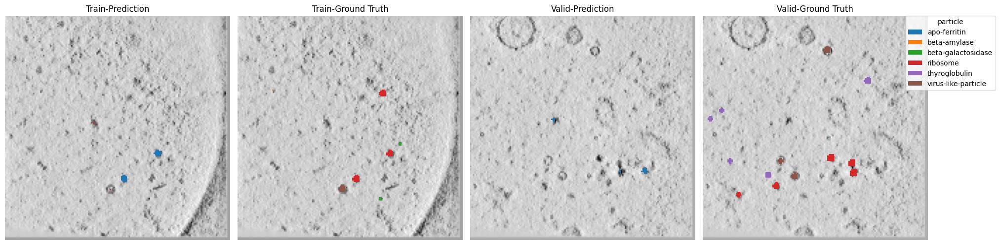

Train-Epoch: 25, Loss: 0.7937751213709513: : 6it [00:00, 12.82it/s]                     
Train-nshuffle-Epoch: 25, Loss: 0.7493598577768906: 100%|██████████| 46/46 [00:00<00:00, 137.83it/s]


EPOCH: 25, TRAIN_SCORE: 0.41912933151779624, TRAIN_SCORE_LIST: [0.41912933151779624]
EPOCH: 25, TRAIN_EASY_SCORE: 0.07822073188485403, TRAIN_EASY_SCORE_LIST: [0.07822073188485403]


Valid-Epoch: 25, Loss: 0.8272253670122313: 100%|██████████| 92/92 [00:00<00:00, 115.89it/s]


EPOCH: 25, VALID_SCORE: 0.1473530032999946, VALID_SCORE_LIST: [0.12475668781264011, 0.16994931878734906]
EPOCH: 25, VALID_EASY_SCORE: 0.0874060831326422, VALID_EASY_SCORE_LIST: [0.07747877254656808, 0.09733339371871633]


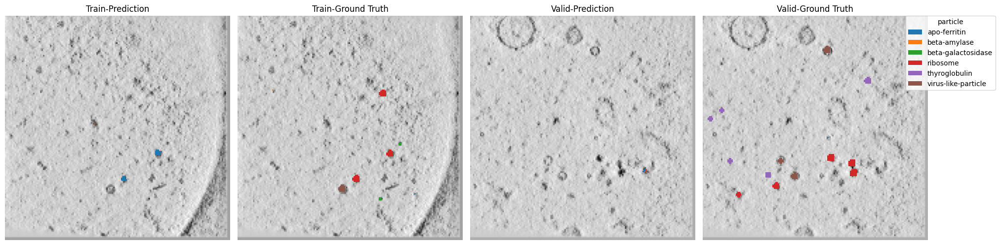

Train-Epoch: 26, Loss: 0.7567240099112192: : 6it [00:00, 12.46it/s]                     
Train-nshuffle-Epoch: 26, Loss: 0.7066149180350096: 100%|██████████| 46/46 [00:00<00:00, 153.21it/s]


EPOCH: 26, TRAIN_SCORE: 0.3448331767521634, TRAIN_SCORE_LIST: [0.3448331767521634]
EPOCH: 26, TRAIN_EASY_SCORE: 0.06935671690739134, TRAIN_EASY_SCORE_LIST: [0.06935671690739134]


Valid-Epoch: 26, Loss: 0.815009215603704: 100%|██████████| 92/92 [00:00<00:00, 115.79it/s] 


EPOCH: 26, VALID_SCORE: 0.12081806683035687, VALID_SCORE_LIST: [0.11797062386165107, 0.12366550979906268]
EPOCH: 26, VALID_EASY_SCORE: 0.0890712280456209, VALID_EASY_SCORE_LIST: [0.10501870576087564, 0.07312375033036614]


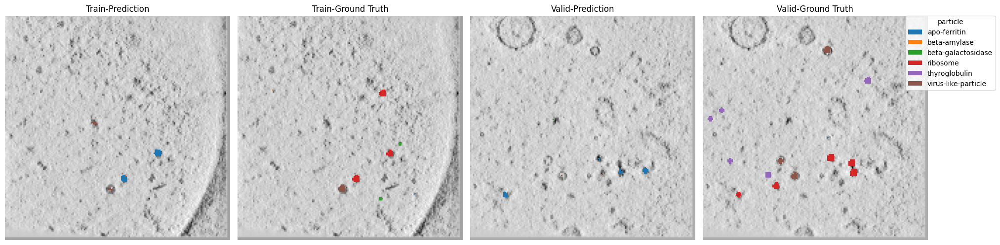

Train-Epoch: 27, Loss: 0.7585842609405518: : 6it [00:00, 11.82it/s]                     
Train-nshuffle-Epoch: 27, Loss: 0.6954641510610995: 100%|██████████| 46/46 [00:00<00:00, 140.44it/s]


EPOCH: 27, TRAIN_SCORE: 0.3456996252068956, TRAIN_SCORE_LIST: [0.3456996252068956]
EPOCH: 27, TRAIN_EASY_SCORE: 0.06955569201611432, TRAIN_EASY_SCORE_LIST: [0.06955569201611432]


Valid-Epoch: 27, Loss: 0.8092898473791454: 100%|██████████| 92/92 [00:00<00:00, 111.95it/s]


EPOCH: 27, VALID_SCORE: 0.10088412184973988, VALID_SCORE_LIST: [0.1331409955217038, 0.06862724817777596]
EPOCH: 27, VALID_EASY_SCORE: 0.07550599899767452, VALID_EASY_SCORE_LIST: [0.08014368687289151, 0.07086831112245752]


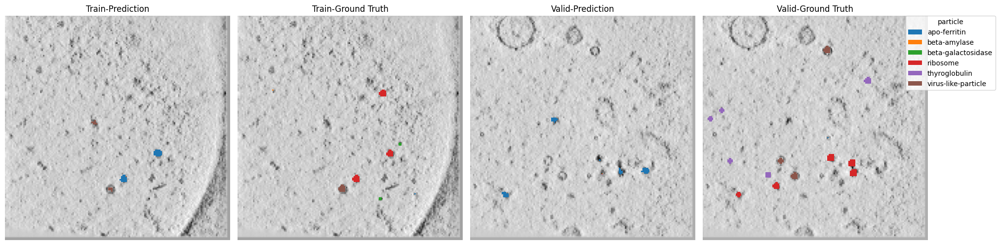

Train-Epoch: 28, Loss: 0.7496127684911092: : 6it [00:00, 12.15it/s]                     
Train-nshuffle-Epoch: 28, Loss: 0.6891841525616853: 100%|██████████| 46/46 [00:00<00:00, 140.84it/s]


EPOCH: 28, TRAIN_SCORE: 0.3108279218094899, TRAIN_SCORE_LIST: [0.3108279218094899]
EPOCH: 28, TRAIN_EASY_SCORE: 0.06741743606762036, TRAIN_EASY_SCORE_LIST: [0.06741743606762036]


Valid-Epoch: 28, Loss: 0.814425031128137: 100%|██████████| 92/92 [00:00<00:00, 123.20it/s] 


EPOCH: 28, VALID_SCORE: 0.11417978616111979, VALID_SCORE_LIST: [0.14797907751809553, 0.08038049480414407]
EPOCH: 28, VALID_EASY_SCORE: 0.06795557159817206, VALID_EASY_SCORE_LIST: [0.06842036323030788, 0.06749077996603624]


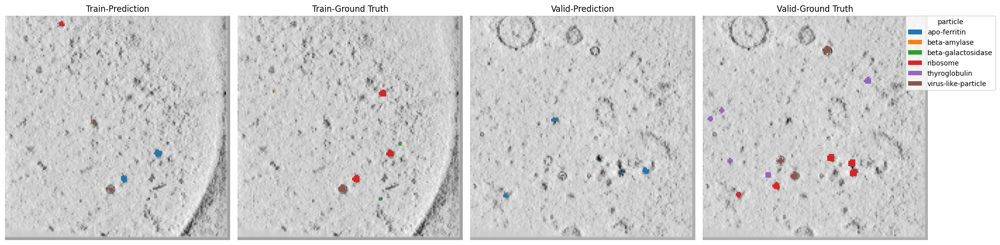

Train-Epoch: 29, Loss: 0.768429716428121: : 6it [00:00, 15.67it/s]                      
Train-nshuffle-Epoch: 29, Loss: 0.6819477146086486: 100%|██████████| 46/46 [00:00<00:00, 139.78it/s]


EPOCH: 29, TRAIN_SCORE: 0.32664948229322716, TRAIN_SCORE_LIST: [0.32664948229322716]
EPOCH: 29, TRAIN_EASY_SCORE: 0.06815139068523378, TRAIN_EASY_SCORE_LIST: [0.06815139068523378]


Valid-Epoch: 29, Loss: 0.8111152597095656: 100%|██████████| 92/92 [00:00<00:00, 115.40it/s]


EPOCH: 29, VALID_SCORE: 0.10959600339567577, VALID_SCORE_LIST: [0.1424172170179674, 0.07677478977338414]
EPOCH: 29, VALID_EASY_SCORE: 0.0670119183743553, VALID_EASY_SCORE_LIST: [0.061884369770175925, 0.07213946697853468]


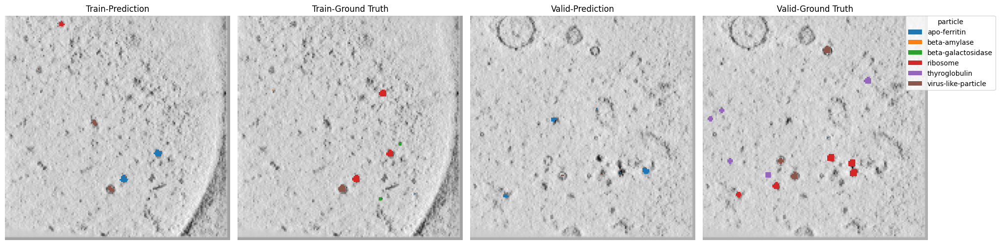

Train-Epoch: 30, Loss: 0.7396916846434275: : 6it [00:00, 15.62it/s]                     
Train-nshuffle-Epoch: 30, Loss: 0.6733363309632177: 100%|██████████| 46/46 [00:00<00:00, 149.31it/s]


EPOCH: 30, TRAIN_SCORE: 0.2872665568623617, TRAIN_SCORE_LIST: [0.2872665568623617]
EPOCH: 30, TRAIN_EASY_SCORE: 0.06633141294533718, TRAIN_EASY_SCORE_LIST: [0.06633141294533718]


Valid-Epoch: 30, Loss: 0.814188930651416: 100%|██████████| 92/92 [00:00<00:00, 110.84it/s] 


EPOCH: 30, VALID_SCORE: 0.11865734038295582, VALID_SCORE_LIST: [0.13780702953499557, 0.09950765123091607]
EPOCH: 30, VALID_EASY_SCORE: 0.06464119834368628, VALID_EASY_SCORE_LIST: [0.0593022978919958, 0.06998009879537678]


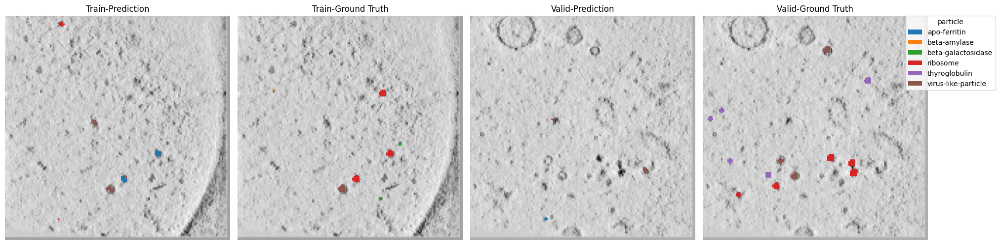

Train-Epoch: 31, Loss: 0.7657494246959686: : 6it [00:00, 13.25it/s]                     
Train-nshuffle-Epoch: 31, Loss: 0.6732590833435887: 100%|██████████| 46/46 [00:00<00:00, 121.06it/s]


EPOCH: 31, TRAIN_SCORE: 0.2374678279783798, TRAIN_SCORE_LIST: [0.2374678279783798]
EPOCH: 31, TRAIN_EASY_SCORE: 0.06401196634624766, TRAIN_EASY_SCORE_LIST: [0.06401196634624766]


Valid-Epoch: 31, Loss: 0.8088256353917329: 100%|██████████| 92/92 [00:00<00:00, 127.76it/s]


EPOCH: 31, VALID_SCORE: 0.11695574490873599, VALID_SCORE_LIST: [0.13573008789296243, 0.09818140192450955]
EPOCH: 31, VALID_EASY_SCORE: 0.06000234299650466, VALID_EASY_SCORE_LIST: [0.05744026149132154, 0.06256442450168778]


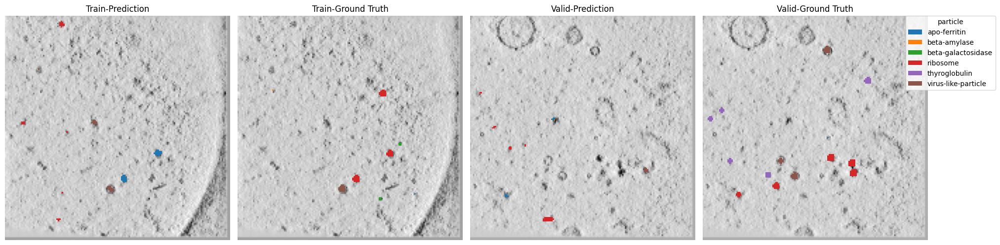

Train-Epoch: 32, Loss: 0.7545814315478007: : 6it [00:00, 12.63it/s]                     
Train-nshuffle-Epoch: 32, Loss: 0.6600559198338053: 100%|██████████| 46/46 [00:00<00:00, 143.58it/s]


EPOCH: 32, TRAIN_SCORE: 0.3613227279167112, TRAIN_SCORE_LIST: [0.3613227279167112]
EPOCH: 32, TRAIN_EASY_SCORE: 0.07211133553227038, TRAIN_EASY_SCORE_LIST: [0.07211133553227038]


Valid-Epoch: 32, Loss: 0.8170953768750896: 100%|██████████| 92/92 [00:00<00:00, 113.08it/s]


EPOCH: 32, VALID_SCORE: 0.1247759871494726, VALID_SCORE_LIST: [0.14188762148327336, 0.10766435281567184]
EPOCH: 32, VALID_EASY_SCORE: 0.06119626667659922, VALID_EASY_SCORE_LIST: [0.054173256825700435, 0.068219276527498]


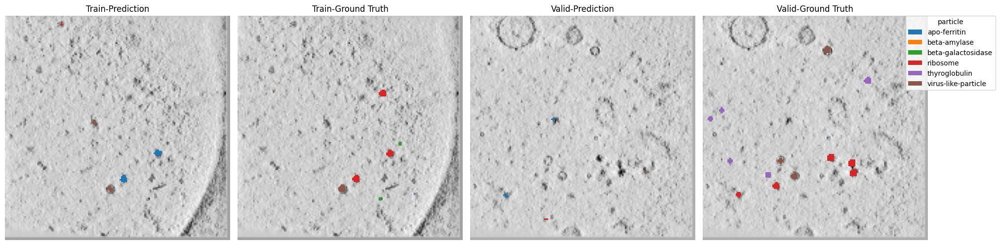

Train-Epoch: 33, Loss: 0.7430436511834463: : 6it [00:00, 13.72it/s]                     
Train-nshuffle-Epoch: 33, Loss: 0.6567605863446775: 100%|██████████| 46/46 [00:00<00:00, 112.12it/s]


EPOCH: 33, TRAIN_SCORE: 0.3564919584331489, TRAIN_SCORE_LIST: [0.3564919584331489]
EPOCH: 33, TRAIN_EASY_SCORE: 0.07039696504212632, TRAIN_EASY_SCORE_LIST: [0.07039696504212632]


Valid-Epoch: 33, Loss: 0.8145123208346574: 100%|██████████| 92/92 [00:00<00:00, 112.36it/s]


EPOCH: 33, VALID_SCORE: 0.13841633571261397, VALID_SCORE_LIST: [0.15101016372904946, 0.12582250769617845]
EPOCH: 33, VALID_EASY_SCORE: 0.06332472763192565, VALID_EASY_SCORE_LIST: [0.060239062215248565, 0.06641039304860274]


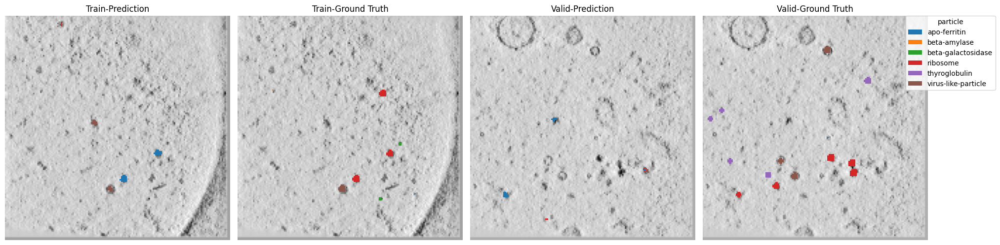

Train-Epoch: 34, Loss: 0.744391550620397: : 6it [00:00, 16.15it/s]                      
Train-nshuffle-Epoch: 34, Loss: 0.6563285822453706: 100%|██████████| 46/46 [00:00<00:00, 144.24it/s]


EPOCH: 34, TRAIN_SCORE: 0.3481998172676414, TRAIN_SCORE_LIST: [0.3481998172676414]
EPOCH: 34, TRAIN_EASY_SCORE: 0.06893531934718264, TRAIN_EASY_SCORE_LIST: [0.06893531934718264]


Valid-Epoch: 34, Loss: 0.8093739398147749: 100%|██████████| 92/92 [00:00<00:00, 117.36it/s]


EPOCH: 34, VALID_SCORE: 0.13785598166545876, VALID_SCORE_LIST: [0.1539972994591737, 0.12171466387174382]
EPOCH: 34, VALID_EASY_SCORE: 0.06341486957351936, VALID_EASY_SCORE_LIST: [0.060181606843155065, 0.06664813230388365]


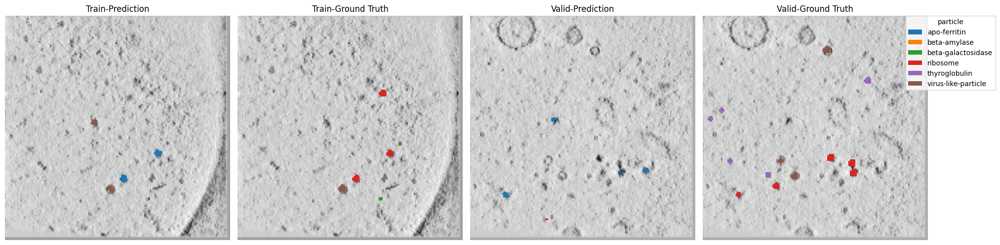

Train-Epoch: 35, Loss: 0.7568247814973196: : 6it [00:00, 13.55it/s]                     
Train-nshuffle-Epoch: 35, Loss: 0.6525996314442676: 100%|██████████| 46/46 [00:00<00:00, 143.28it/s]


EPOCH: 35, TRAIN_SCORE: 0.33475676861758025, TRAIN_SCORE_LIST: [0.33475676861758025]
EPOCH: 35, TRAIN_EASY_SCORE: 0.06894134959857912, TRAIN_EASY_SCORE_LIST: [0.06894134959857912]


Valid-Epoch: 35, Loss: 0.8101148702528166: 100%|██████████| 92/92 [00:00<00:00, 118.35it/s]


EPOCH: 35, VALID_SCORE: 0.12844535981253816, VALID_SCORE_LIST: [0.14634010782370271, 0.11055061180137359]
EPOCH: 35, VALID_EASY_SCORE: 0.06367561906155388, VALID_EASY_SCORE_LIST: [0.06219976939573779, 0.06515146872736996]


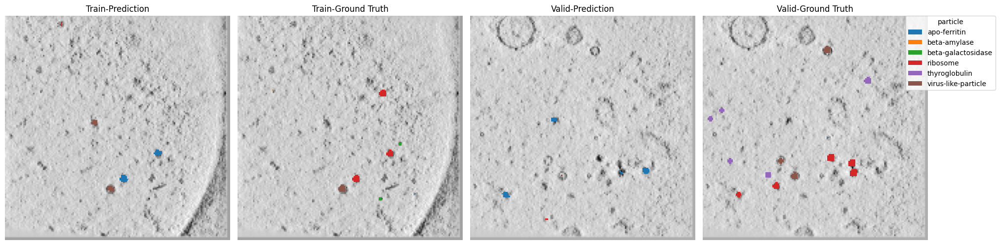

Train-Epoch: 36, Loss: 0.7417591611544291: : 6it [00:00, 14.83it/s]                     
Train-nshuffle-Epoch: 36, Loss: 0.6505289336909419: 100%|██████████| 46/46 [00:00<00:00, 139.36it/s]


EPOCH: 36, TRAIN_SCORE: 0.3890145281449629, TRAIN_SCORE_LIST: [0.3890145281449629]
EPOCH: 36, TRAIN_EASY_SCORE: 0.07325222177213071, TRAIN_EASY_SCORE_LIST: [0.07325222177213071]


Valid-Epoch: 36, Loss: 0.8129331106724946: 100%|██████████| 92/92 [00:00<00:00, 120.92it/s]


EPOCH: 36, VALID_SCORE: 0.14173201355447387, VALID_SCORE_LIST: [0.1618531110554034, 0.12161091605354435]
EPOCH: 36, VALID_EASY_SCORE: 0.06538405076051688, VALID_EASY_SCORE_LIST: [0.06216451175564024, 0.06860358976539353]


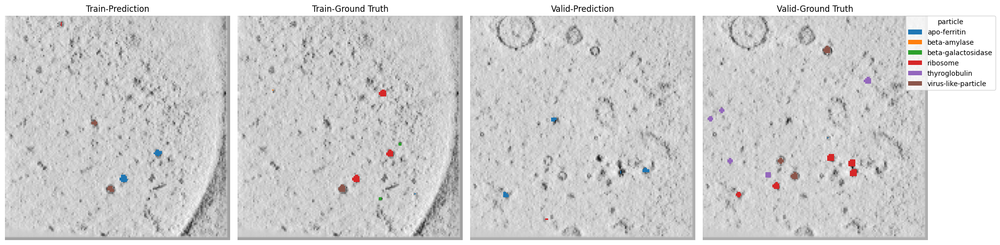

Train-Epoch: 37, Loss: 0.7439909080664316: : 6it [00:00, 14.47it/s]                     
Train-nshuffle-Epoch: 37, Loss: 0.649792009073755: 100%|██████████| 46/46 [00:00<00:00, 127.38it/s] 


EPOCH: 37, TRAIN_SCORE: 0.3766989460632112, TRAIN_SCORE_LIST: [0.3766989460632112]
EPOCH: 37, TRAIN_EASY_SCORE: 0.07257654477249433, TRAIN_EASY_SCORE_LIST: [0.07257654477249433]


Valid-Epoch: 37, Loss: 0.8154536569895952: 100%|██████████| 92/92 [00:00<00:00, 118.19it/s]


EPOCH: 37, VALID_SCORE: 0.1413503719190773, VALID_SCORE_LIST: [0.15122500745681092, 0.13147573638134363]
EPOCH: 37, VALID_EASY_SCORE: 0.06292161522728945, VALID_EASY_SCORE_LIST: [0.058486274346821, 0.0673569561077579]


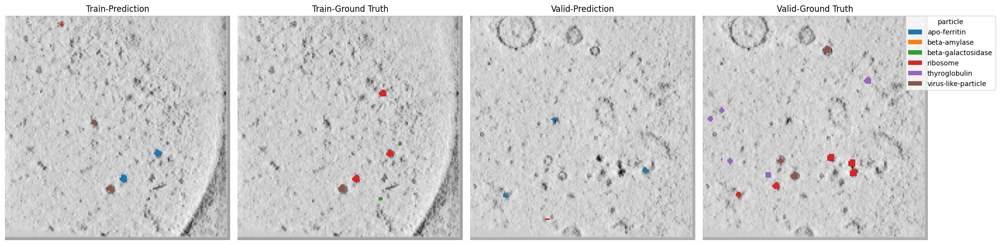

Train-Epoch: 38, Loss: 0.7043863038221995: : 6it [00:00, 10.84it/s]                     
Train-nshuffle-Epoch: 38, Loss: 0.650908350944519: 100%|██████████| 46/46 [00:00<00:00, 137.67it/s] 


EPOCH: 38, TRAIN_SCORE: 0.39593353506396983, TRAIN_SCORE_LIST: [0.39593353506396983]
EPOCH: 38, TRAIN_EASY_SCORE: 0.07325222177213071, TRAIN_EASY_SCORE_LIST: [0.07325222177213071]


Valid-Epoch: 38, Loss: 0.8172391374473986: 100%|██████████| 92/92 [00:00<00:00, 114.86it/s]


EPOCH: 38, VALID_SCORE: 0.1310814683294932, VALID_SCORE_LIST: [0.14450466583347607, 0.11765827082551028]
EPOCH: 38, VALID_EASY_SCORE: 0.06523655651907838, VALID_EASY_SCORE_LIST: [0.05861946742984375, 0.071853645608313]


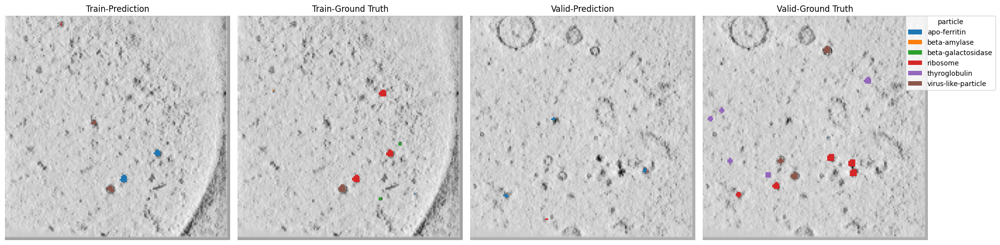

Train-Epoch: 39, Loss: 0.7449827492237091: : 6it [00:00, 12.84it/s]                     
Train-nshuffle-Epoch: 39, Loss: 0.6485138250433881: 100%|██████████| 46/46 [00:00<00:00, 130.12it/s]


EPOCH: 39, TRAIN_SCORE: 0.38021473550139795, TRAIN_SCORE_LIST: [0.38021473550139795]
EPOCH: 39, TRAIN_EASY_SCORE: 0.07314813406206504, TRAIN_EASY_SCORE_LIST: [0.07314813406206504]


Valid-Epoch: 39, Loss: 0.8167971165283866: 100%|██████████| 92/92 [00:00<00:00, 96.87it/s] 


EPOCH: 39, VALID_SCORE: 0.13753635564092193, VALID_SCORE_LIST: [0.1457334993465888, 0.12933921193525508]
EPOCH: 39, VALID_EASY_SCORE: 0.06370349779227687, VALID_EASY_SCORE_LIST: [0.059916755275677816, 0.06749024030887592]


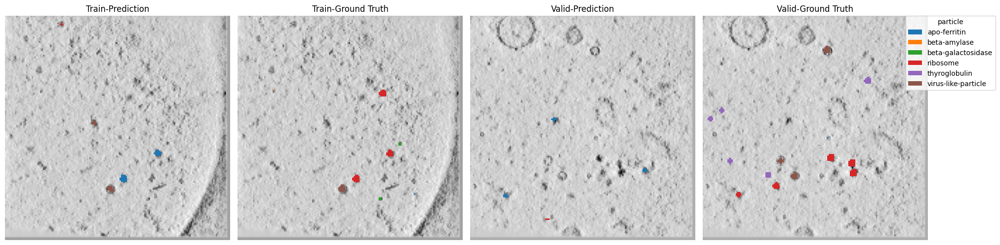

Train-Epoch: 40, Loss: 0.7146721879641215: : 6it [00:00, 12.61it/s]                     
Train-nshuffle-Epoch: 40, Loss: 0.6489702553852744: 100%|██████████| 46/46 [00:00<00:00, 94.73it/s] 


EPOCH: 40, TRAIN_SCORE: 0.3977738767043129, TRAIN_SCORE_LIST: [0.3977738767043129]
EPOCH: 40, TRAIN_EASY_SCORE: 0.07405473229088289, TRAIN_EASY_SCORE_LIST: [0.07405473229088289]


Valid-Epoch: 40, Loss: 0.8167282342910767: 100%|██████████| 92/92 [00:00<00:00, 107.35it/s]


EPOCH: 40, VALID_SCORE: 0.13483150894424983, VALID_SCORE_LIST: [0.14705230198187944, 0.12261071590662025]
EPOCH: 40, VALID_EASY_SCORE: 0.06501240082137781, VALID_EASY_SCORE_LIST: [0.05845651078765731, 0.0715682908550983]


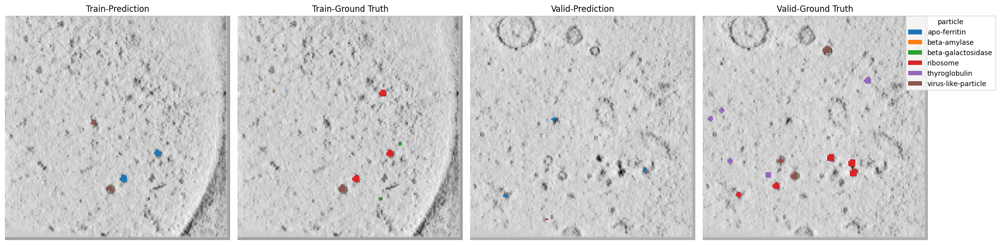

Train-Epoch: 41, Loss: 0.7095190485318502: : 6it [00:00, 15.07it/s]                     
Train-nshuffle-Epoch: 41, Loss: 0.6496461461419645: 100%|██████████| 46/46 [00:00<00:00, 125.73it/s]


EPOCH: 41, TRAIN_SCORE: 0.4030281947902085, TRAIN_SCORE_LIST: [0.4030281947902085]
EPOCH: 41, TRAIN_EASY_SCORE: 0.07355945965275411, TRAIN_EASY_SCORE_LIST: [0.07355945965275411]


Valid-Epoch: 41, Loss: 0.8169413170088893: 100%|██████████| 92/92 [00:01<00:00, 75.50it/s]


EPOCH: 41, VALID_SCORE: 0.13949411714283994, VALID_SCORE_LIST: [0.1535000529042329, 0.12548818138144693]
EPOCH: 41, VALID_EASY_SCORE: 0.06664358473706773, VALID_EASY_SCORE_LIST: [0.06070984020386063, 0.07257732927027484]


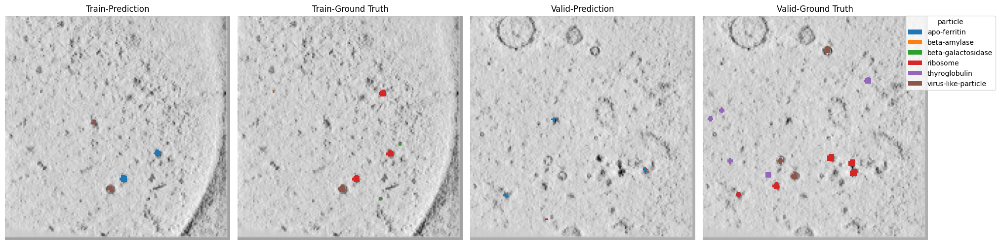

Train-Epoch: 42, Loss: 0.7263107597827911: : 6it [00:00, 15.75it/s]                     
Train-nshuffle-Epoch: 42, Loss: 0.6495136048482812: 100%|██████████| 46/46 [00:00<00:00, 146.00it/s]


EPOCH: 42, TRAIN_SCORE: 0.3977738767043129, TRAIN_SCORE_LIST: [0.3977738767043129]
EPOCH: 42, TRAIN_EASY_SCORE: 0.07405473229088289, TRAIN_EASY_SCORE_LIST: [0.07405473229088289]


Valid-Epoch: 42, Loss: 0.8177911542032076: 100%|██████████| 92/92 [00:00<00:00, 119.62it/s]


EPOCH: 42, VALID_SCORE: 0.13373471109724683, VALID_SCORE_LIST: [0.15128093423669936, 0.11618848795779427]
EPOCH: 42, VALID_EASY_SCORE: 0.06661078724879815, VALID_EASY_SCORE_LIST: [0.06186074772931738, 0.07136082676827891]


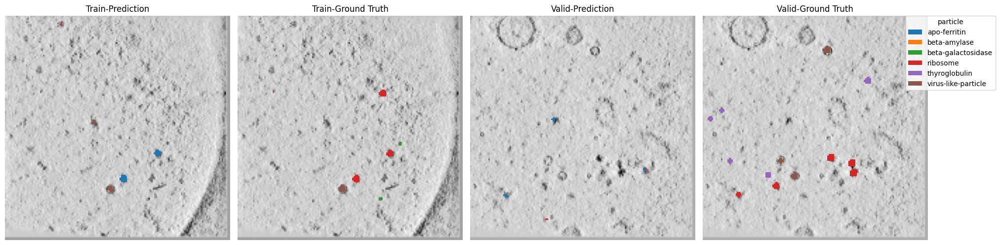

Train-Epoch: 43, Loss: 0.7214143176873525: : 6it [00:00, 14.12it/s]                     
Train-nshuffle-Epoch: 43, Loss: 0.649405978296114: 100%|██████████| 46/46 [00:00<00:00, 147.27it/s] 


EPOCH: 43, TRAIN_SCORE: 0.39364096859229886, TRAIN_SCORE_LIST: [0.39364096859229886]
EPOCH: 43, TRAIN_EASY_SCORE: 0.07359866253903848, TRAIN_EASY_SCORE_LIST: [0.07359866253903848]


Valid-Epoch: 43, Loss: 0.8185757061709529: 100%|██████████| 92/92 [00:00<00:00, 113.62it/s]


EPOCH: 43, VALID_SCORE: 0.13620298698300956, VALID_SCORE_LIST: [0.14767538984656062, 0.12473058411945849]
EPOCH: 43, VALID_EASY_SCORE: 0.06603025097730136, VALID_EASY_SCORE_LIST: [0.061794150766753646, 0.07026635118784909]


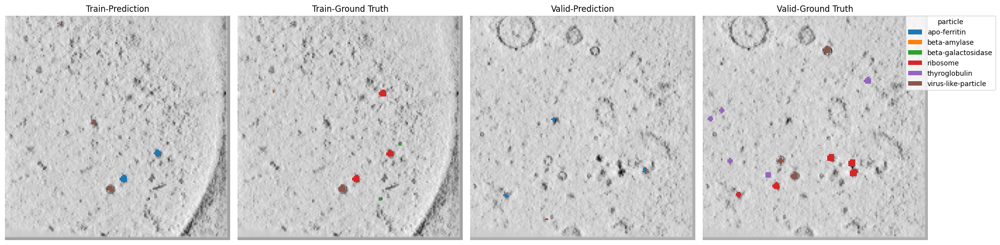

Train-Epoch: 44, Loss: 0.7472517391045889: : 6it [00:00, 14.94it/s]                     
Train-nshuffle-Epoch: 44, Loss: 0.64847731590271: 100%|██████████| 46/46 [00:00<00:00, 127.21it/s]  


EPOCH: 44, TRAIN_SCORE: 0.40263641172903003, TRAIN_SCORE_LIST: [0.40263641172903003]
EPOCH: 44, TRAIN_EASY_SCORE: 0.07369996915173264, TRAIN_EASY_SCORE_LIST: [0.07369996915173264]


Valid-Epoch: 44, Loss: 0.8155873061522193: 100%|██████████| 92/92 [00:00<00:00, 118.04it/s]


EPOCH: 44, VALID_SCORE: 0.13774233356960972, VALID_SCORE_LIST: [0.1444619350676383, 0.13102273207158113]
EPOCH: 44, VALID_EASY_SCORE: 0.06438663760060034, VALID_EASY_SCORE_LIST: [0.05880659718008847, 0.06996667802111221]


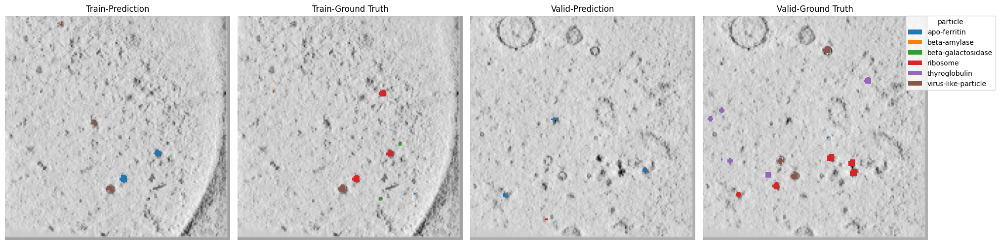

Train-Epoch: 45, Loss: 0.7319923341274261: : 6it [00:00, 10.93it/s]                     
Train-nshuffle-Epoch: 45, Loss: 0.6476695680099985: 100%|██████████| 46/46 [00:00<00:00, 110.08it/s]


EPOCH: 45, TRAIN_SCORE: 0.3847457984444619, TRAIN_SCORE_LIST: [0.3847457984444619]
EPOCH: 45, TRAIN_EASY_SCORE: 0.07264807944922959, TRAIN_EASY_SCORE_LIST: [0.07264807944922959]


Valid-Epoch: 45, Loss: 0.8156081029902333: 100%|██████████| 92/92 [00:00<00:00, 109.69it/s]


EPOCH: 45, VALID_SCORE: 0.13484497759957556, VALID_SCORE_LIST: [0.14591823490093483, 0.12377172029821627]
EPOCH: 45, VALID_EASY_SCORE: 0.06450831616161211, VALID_EASY_SCORE_LIST: [0.0611924863921991, 0.06782414593102512]


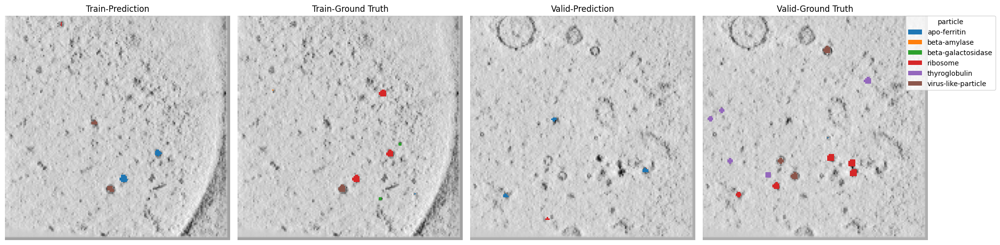

Train-Epoch: 46, Loss: 0.7298679451147715: : 6it [00:00, 13.33it/s]                     
Train-nshuffle-Epoch: 46, Loss: 0.6474063811094865: 100%|██████████| 46/46 [00:00<00:00, 98.73it/s] 


EPOCH: 46, TRAIN_SCORE: 0.3830008343083908, TRAIN_SCORE_LIST: [0.3830008343083908]
EPOCH: 46, TRAIN_EASY_SCORE: 0.07269206431022066, TRAIN_EASY_SCORE_LIST: [0.07269206431022066]


Valid-Epoch: 46, Loss: 0.8156907998997233: 100%|██████████| 92/92 [00:00<00:00, 115.65it/s]


EPOCH: 46, VALID_SCORE: 0.1387545215134358, VALID_SCORE_LIST: [0.1537467621865376, 0.12376228084033404]
EPOCH: 46, VALID_EASY_SCORE: 0.06476088712996501, VALID_EASY_SCORE_LIST: [0.060851683215763265, 0.06867009104416676]


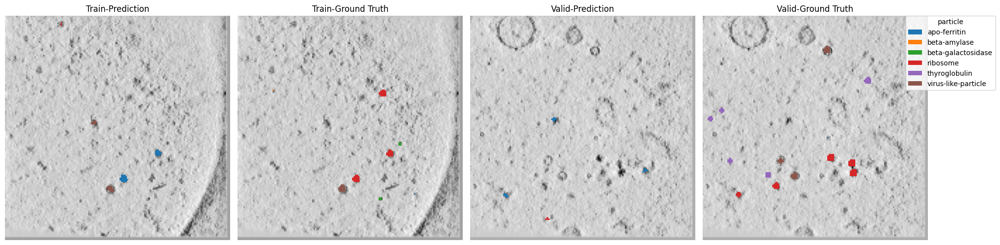

Train-Epoch: 47, Loss: 0.7650985717773438: : 6it [00:00, 13.27it/s]                     
Train-nshuffle-Epoch: 47, Loss: 0.6464183498983798: 100%|██████████| 46/46 [00:00<00:00, 128.34it/s]


EPOCH: 47, TRAIN_SCORE: 0.4193589568513173, TRAIN_SCORE_LIST: [0.4193589568513173]
EPOCH: 47, TRAIN_EASY_SCORE: 0.07485381841322698, TRAIN_EASY_SCORE_LIST: [0.07485381841322698]


Valid-Epoch: 47, Loss: 0.8165907088829123: 100%|██████████| 92/92 [00:00<00:00, 101.56it/s]


EPOCH: 47, VALID_SCORE: 0.12505103681447122, VALID_SCORE_LIST: [0.13932225489521238, 0.11077981873373004]
EPOCH: 47, VALID_EASY_SCORE: 0.06675407244263737, VALID_EASY_SCORE_LIST: [0.059293018200403225, 0.0742151266848715]


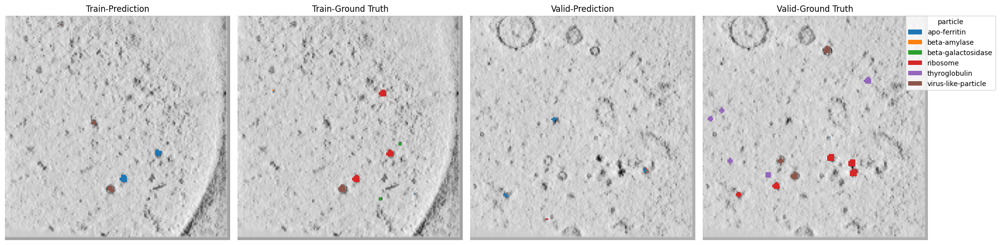

Train-Epoch: 48, Loss: 0.7492850522200266: : 6it [00:00, 15.50it/s]                     
Train-nshuffle-Epoch: 48, Loss: 0.6455361376637998: 100%|██████████| 46/46 [00:00<00:00, 139.56it/s]


EPOCH: 48, TRAIN_SCORE: 0.41473071892812563, TRAIN_SCORE_LIST: [0.41473071892812563]
EPOCH: 48, TRAIN_EASY_SCORE: 0.07434329257161011, TRAIN_EASY_SCORE_LIST: [0.07434329257161011]


Valid-Epoch: 48, Loss: 0.81311304413754: 100%|██████████| 92/92 [00:00<00:00, 101.23it/s]  


EPOCH: 48, VALID_SCORE: 0.12590459301507123, VALID_SCORE_LIST: [0.14112620848243734, 0.1106829775477051]
EPOCH: 48, VALID_EASY_SCORE: 0.06723653436175424, VALID_EASY_SCORE_LIST: [0.06128830218798039, 0.07318476653552808]


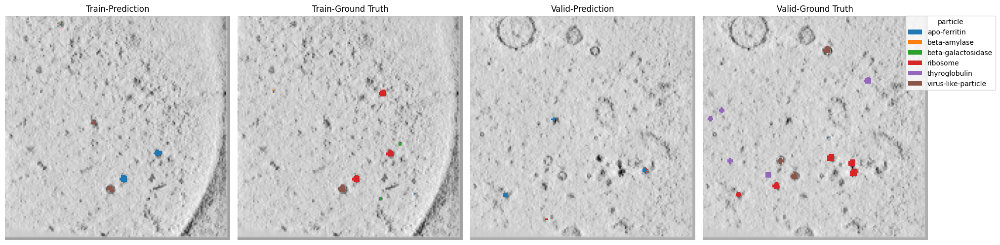

Train-Epoch: 49, Loss: 0.7309236327807108: : 6it [00:00, 23.93it/s]                     
Train-nshuffle-Epoch: 49, Loss: 0.6436384760815165: 100%|██████████| 46/46 [00:00<00:00, 141.82it/s]


EPOCH: 49, TRAIN_SCORE: 0.36779705002701524, TRAIN_SCORE_LIST: [0.36779705002701524]
EPOCH: 49, TRAIN_EASY_SCORE: 0.07178436933611178, TRAIN_EASY_SCORE_LIST: [0.07178436933611178]


Valid-Epoch: 49, Loss: 0.810125518752181: 100%|██████████| 92/92 [00:00<00:00, 108.88it/s] 


EPOCH: 49, VALID_SCORE: 0.1428156004089303, VALID_SCORE_LIST: [0.15940824957422234, 0.12622295124363825]
EPOCH: 49, VALID_EASY_SCORE: 0.0641227823413516, VALID_EASY_SCORE_LIST: [0.058233450416439625, 0.07001211426626357]


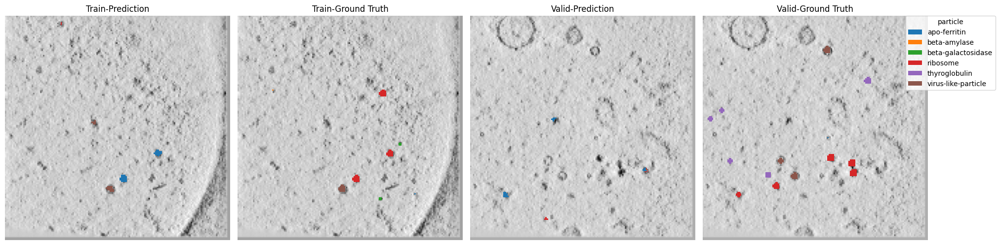

In [8]:
best_model = None
best_score = 0

for epoch in range(CFG.epochs):
    train_loss = []
    train_nshuffle_loss = []
    valid_loss = []

    # train_original_tomogram = defaultdict(list)
    ##train_pred_tomogram = defaultdict(list)
    # train_gt_tomogram = defaultdict(list)

    train_nshuffle_original_tomogram = defaultdict(list)
    train_nshuffle_pred_tomogram = defaultdict(list)
    train_nshuffle_gt_tomogram = defaultdict(list)

    valid_original_tomogram = defaultdict(list)
    valid_pred_tomogram = defaultdict(list)
    valid_gt_tomogram = defaultdict(list)

    model.train()
    tq = tqdm(range(len(train_loader) * normalized_tomogram.shape[0] // batch_size))
    for data in train_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"]
        segmentation_map = data["segmentation_map"]

        tomogram = tomogram.reshape(1, -1, tomogram.shape[-2], tomogram.shape[-1])
        segmentation_map = segmentation_map.reshape(
            1, -1, segmentation_map.shape[-2], segmentation_map.shape[-1]
        )

        for i in range(0, tomogram.shape[1], batch_size):
            optimizer.zero_grad()
            input_ = tomogram[:, i : i + batch_size].to("cuda").transpose(0, 1)
            gt = segmentation_map[:, i : i + batch_size].to("cuda").long().squeeze()
            # print(input_.shape, gt.shape)

            input_ = padf(input_)
            gt = padf(gt)
            input_, gt = aug(input_, gt)
            output = model(input_)
            loss = seg_loss(output, gt)
            loss.backward()
            optimizer.step()
            scheduler.step()

            train_loss.append(loss.item())
            tq.set_description(f"Train-Epoch: {epoch}, Loss: {np.mean(train_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            # train_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            # train_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    train_exp_name = exp_name

    ######################################## train-nshuffle #########################################
    model.eval()
    tq = tqdm(range(len(train_nshuffle_loader) * normalized_tomogram.shape[0]))
    for data in train_nshuffle_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        train_nshuffle_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            train_nshuffle_loss.append(loss.item())
            tq.set_description(
                f"Train-nshuffle-Epoch: {epoch}, Loss: {np.mean(train_nshuffle_loss)}"
            )
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            train_nshuffle_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            train_nshuffle_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()

    train_score_, train_score_list = visualize_epoch_results(
        train_nshuffle_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )
    print(
        f"EPOCH: {epoch}, TRAIN_SCORE: {train_score_}, TRAIN_SCORE_LIST: {train_score_list}"
    )

    train_easy_score_, train_easy_score_list = visualize_epoch_results(
        train_nshuffle_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
        gt_tomogram_dict=train_nshuffle_gt_tomogram,
    )
    print(
        f"EPOCH: {epoch}, TRAIN_EASY_SCORE: {train_easy_score_}, TRAIN_EASY_SCORE_LIST: {train_easy_score_list}"
    )

    ############################################# valid #############################################

    model.eval()
    tq = tqdm(range(len(valid_loader) * normalized_tomogram.shape[0]))
    for data in valid_loader:
        exp_name = data["exp_name"][0]
        tomogram = data["normalized_tomogram"].to("cuda")
        segmentation_map = data["segmentation_map"].to("cuda").long()

        valid_original_tomogram[exp_name] = (
            padf(tomogram).squeeze().cpu().detach().numpy()
        )

        for i in range(tomogram.shape[1]):
            input_ = tomogram[:, i].unsqueeze(0)
            gt = segmentation_map[:, i]

            input_ = padf(input_)
            gt = padf(gt)
            output = model(input_)
            loss = seg_loss(output, gt)

            valid_loss.append(loss.item())
            tq.set_description(f"Valid-Epoch: {epoch}, Loss: {np.mean(valid_loss)}")
            tq.update(1)

            # print(output.shape, gt.shape) # torch.Size([1, 7, 160, 160]) torch.Size([1, 160, 160])
            valid_pred_tomogram[exp_name].append(output.cpu().detach().numpy())
            valid_gt_tomogram[exp_name].append(gt.cpu().detach().numpy())
    tq.close()
    valid_exp_name = exp_name

    valid_score_, valid_score_list = visualize_epoch_results(
        valid_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
    )
    print(
        f"EPOCH: {epoch}, VALID_SCORE: {valid_score_}, VALID_SCORE_LIST: {valid_score_list}"
    )
    valid_easy_score_, valid_easy_score_list = visualize_epoch_results(
        valid_pred_tomogram,
        base_dir="../../inputs/train/overlay/ExperimentRuns/",
        sikii_dict=CFG.initial_sikii,
        gt_tomogram_dict=valid_gt_tomogram,
    )
    print(
        f"EPOCH: {epoch}, VALID_EASY_SCORE: {valid_easy_score_}, VALID_EASY_SCORE_LIST: {valid_easy_score_list}"
    )

    if valid_score_ > best_score:
        best_score = valid_score_
        best_model = model
        torch.save(model.state_dict(), f"best_model.pth")

    # 描画
    index = 30
    plt.figure(figsize=(20, 5))

    # Train-Pred-Plot
    ax = plt.subplot(1, 4, 1)
    pred = train_nshuffle_pred_tomogram[train_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred,
        "Train-Prediction",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Train-GT-Plot
    ax = plt.subplot(1, 4, 2)
    gt = train_nshuffle_gt_tomogram[train_exp_name][index][0]
    plot_with_colormap(
        gt,
        "Train-Ground Truth",
        train_nshuffle_original_tomogram[train_exp_name][index],
    )

    # Valid-Pred-Plot
    ax = plt.subplot(1, 4, 3)
    pred = valid_pred_tomogram[valid_exp_name][index][0].argmax(0)
    plot_with_colormap(
        pred, "Valid-Prediction", valid_original_tomogram[valid_exp_name][index]
    )

    # Valid-GT-Plot
    ax = plt.subplot(1, 4, 4)
    gt = valid_gt_tomogram[valid_exp_name][index][0]
    plot_with_colormap(
        gt, "Valid-Ground Truth", valid_original_tomogram[valid_exp_name][index]
    )

    # 凡例を追加
    legend_elements = [
        Patch(facecolor=colors[i - 1], label=CFG.particles_name[i - 1])
        for i in range(1, num_classes + 1)
    ]
    plt.legend(
        handles=legend_elements,
        loc="upper right",
        title="particle",
        bbox_to_anchor=(1.3, 1),  # 凡例を右上に配置
        borderaxespad=0,
    )

    plt.tight_layout()
    plt.show()

    # torch.save(model.state_dict(), "pretrained_model.pth")